# Human Desease Network

## Library

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive',force_remount=True)
data_dir = '/content/drive/My Drive/DAProject-HDN/data'
os.listdir(data_dir) 

Mounted at /content/drive


['__init__.py', 'nodes.csv', 'edges.csv']

In [ ]:
!sudo apt install build-essential python-dev libxml2 libxml2-dev zlib1g-dev
!sudo pip install cairocffi
!pip install python-igraph
!pip install louvain

Reading package lists... Done
Building dependency tree       
Reading state information... Done
build-essential is already the newest version (12.4ubuntu1).
python-dev is already the newest version (2.7.15~rc1-1).
zlib1g-dev is already the newest version (1:1.2.11.dfsg-0ubuntu2).
libxml2 is already the newest version (2.9.4+dfsg1-6.1ubuntu1.3).
libxml2-dev is already the newest version (2.9.4+dfsg1-6.1ubuntu1.3).
The following package was automatically installed and is no longer required:
  libnvidia-common-440
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 59 not upgraded.


In [ ]:
!cp '/content/drive/My Drive/DAProject-HDN/data/__init__.py' /usr/local/lib/python3.6/dist-packages/igraph/drawing

In [ ]:
# Networks
import igraph as ig
# Data
import pandas as pd
import itertools
# Computation
import numpy as np
np.random.seed(0)
from sklearn.metrics import confusion_matrix
import louvain

## Import CSV

### Nodes CSV

In [ ]:
nodes = pd.read_csv('/content/drive/My Drive/DAProject-HDN/data/nodes.csv') 
nodes = nodes.drop(columns = 'timeset')
print('Nodes')
nodes

Nodes


,id,label,0,1
0,55,Deafness,disease,"Ear,Nose,Throat"
1,47,Leukemia,disease,Cancer
2,114,Colon cancer,disease,Cancer
3,45,Retinitis pigmentosa,disease,Ophthamological
4,87,Diabetes mellitus,disease,Endocrine
...,...,...,...,...
1414,3981,PTPRC,gene,gene
1415,3983,AGT,gene,gene
1416,3984,AGTR1,gene,gene
1417,3985,ACE,gene,gene


### Edges CSV

In [ ]:
edges = pd.read_csv('/content/drive/My Drive/DAProject-HDN/data/edges.csv') 
edges = edges.drop(columns = ['label', 'timeset'])
edges = edges[['Source', 'Target', 'id', 'weight', 'Type']]
print('Edges')
edges

Edges


,Source,Target,id,weight,Type
0,1285,3211,0,1.0,Directed
1,468,2914,1,1.0,Directed
2,416,3825,2,1.0,Directed
3,126,2566,3,1.0,Directed
4,126,1329,4,1.0,Directed
...,...,...,...,...,...
3921,80,365,3921,1.0,Directed
3922,80,87,3922,1.0,Directed
3923,80,99,3923,1.0,Directed
3924,80,366,3924,1.0,Directed


In [ ]:
print('Nodes: {0} diseases, {1} genes'.format((nodes['0'] == 'disease').sum(), (nodes['0'] == 'gene').sum()))

Nodes: 516 diseases, 903 genes


### Edges as Tuples

In [ ]:
tuples = [tuple(x) for x in edges.values]
tuples[:10]

[(1285, 3211, 0, 1.0, 'Directed'),
 (468, 2914, 1, 1.0, 'Directed'),
 (416, 3825, 2, 1.0, 'Directed'),
 (126, 2566, 3, 1.0, 'Directed'),
 (126, 1329, 4, 1.0, 'Directed'),
 (288, 3831, 5, 1.0, 'Directed'),
 (407, 2203, 6, 1.0, 'Directed'),
 (473, 3720, 7, 1.0, 'Directed'),
 (282, 1338, 8, 1.0, 'Directed'),
 (282, 1339, 9, 1.0, 'Directed')]

In [ ]:
# https://igraph.org/python/doc/tutorial/tutorial.html#layouts-and-plotting
g = ig.Graph.TupleList(tuples, directed = True, edge_attrs = ['name', 'weight', 'type'])
# g['layout'] = g.layout_grid_fruchterman_reingold()
ig.plot(g)

In [ ]:
# print(g.summary())
# print(g)

In [ ]:
# https://igraph.org/python/doc/igraph.Graph-class.html
nodes_count = g.vcount()
edges_count = g.ecount()
print('Graph: {0} nodes, {1} edges'.format(nodes_count, edges_count))

Graph: 1419 nodes, 3926 edges


In [ ]:
# DEBUG
if(nodes_count == len(nodes)):
  print('Nodes imported correctly!')
if(edges_count == len(edges)):
  print('Edges imported correctly!')

Nodes imported correctly!
Edges imported correctly!


In [ ]:
print('Attributes of vertex: {0}'.format(g.vs.attribute_names()))
print()
print('Name of first 10 vertex: {0}'.format(g.vs.get_attribute_values('name')[:10]))

Attributes of vertex: ['name']

Name of first 10 vertex: [1285, 3211, 468, 2914, 416, 3825, 126, 2566, 1329, 288]


In [ ]:
for name in g.vs.get_attribute_values('name'):
  # print(name)
  g.vs.select(name = name)["label"] = nodes.loc[nodes['id'] == name, 'label'].item()
  g.vs.select(name = name)["type"] = nodes.loc[nodes['id'] == name, '0'].item()
  g.vs.select(name = name)["category"] = nodes.loc[nodes['id'] == name, '1'].item()

print('Attributes of vertex: {0}'.format(g.vs.attribute_names()))

Attributes of vertex: ['name', 'label', 'type', 'category']


In [ ]:
print('Label of vertex 45: {0}'.format(g.vs.select(name = 45)["label"]))
print('Type of vertex 45: {0}'.format(g.vs.select(name = 45)["type"]))
print('Category of vertex 45: {0}'.format(g.vs.select(name = 45)["category"]))
print()
print('Label of vertex 3985: {0}'.format(g.vs.select(name = 3985)["label"]))
print('Type of vertex 3985: {0}'.format(g.vs.select(name = 3985)["type"]))
print('Category of vertex 3985: {0}'.format(g.vs.select(name = 3985)["category"]))

Label of vertex 45: ['Retinitis pigmentosa']
Type of vertex 45: ['disease']
Category of vertex 45: ['Ophthamological']

Label of vertex 3985: ['ACE']
Type of vertex 3985: ['gene']
Category of vertex 3985: ['gene']


In [ ]:
print('Attributes of edges: {0}'.format(g.es.attribute_names()))
print()
print('Name of first 10 edges: {0}'.format(g.es.get_attribute_values('name')[:10]))
print('Weight of first 10 edges: {0}'.format(g.es.get_attribute_values('weight')[:10]))
print('Type of first 10 edges: {0}'.format(g.es.get_attribute_values('type')[:10]))

Attributes of edges: ['name', 'weight', 'type']

Name of first 10 edges: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Weight of first 10 edges: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
Type of first 10 edges: ['Directed', 'Directed', 'Directed', 'Directed', 'Directed', 'Directed', 'Directed', 'Directed', 'Directed', 'Directed']


In [ ]:
g.vs['color'] = ['blue' if (type == 'disease') else 'green' for type in g.vs['type']]
# print('Color of vertex 45: {0}'.format(g.vs.select(name = 45)["color"]))
# print('Color of vertex 3985: {0}'.format(g.vs.select(name = 3985)["color"]))
ig.plot(g, vertex_label = ' ')

# Network Centrality (before trasformation)

## Degree

In [ ]:
degree_nodes = []
g.vs['degree'] = g.degree(g.vs)
print('Top 5 MAX Degree in G: {0}'.format(sorted(g.vs.get_attribute_values('degree'), reverse=True)[:5]))
for degree in sorted(g.vs.get_attribute_values('degree'), reverse=True)[:5]:
    degree_nodes.append(g.vs.select(degree = degree)["label"])
print('Top 5 vertex_name with MAX Degree in G:')
print(degree_nodes)

Top 5 MAX Degree in G: [134, 91, 89, 79, 75]
Top 5 vertex_name with MAX Degree in G:
[['Colon cancer'], ['Deafness'], ['Leukemia'], ['Breast cancer'], ['Diabetes mellitus']]


In [ ]:
ig.plot(g, main="Degree in G", vertex_label = ' ', vertex_size=1*np.array(g.vs['degree']) + 1)

## Betweenness

In [ ]:
betweenness_nodes = []
g.vs['betweenness'] = g.betweenness(g.vs)
print('Top 5 MAX Betweenness in G: {0}'.format(sorted(g.vs.get_attribute_values('betweenness'), reverse=True)[:5]))
for betweenness in sorted(g.vs.get_attribute_values('betweenness'), reverse=True)[:5]:
    betweenness_nodes.append(g.vs.select(betweenness = betweenness)["label"])
print('Top 5 vertex_name with MAX Betweenness in G:')
print(betweenness_nodes)

Top 5 MAX Betweenness in G: [333925.1435839013, 295411.2642151705, 206496.99152119804, 171869.78909374066, 142497.42691723487]
Top 5 vertex_name with MAX Betweenness in G:
[['Cardiomyopathy'], ['Lipodystrophy'], ['Diabetes mellitus'], ['Glioblastoma'], ['Deafness']]


In [ ]:
ig.plot(g, main="Betweenness in G", vertex_label = ' ', vertex_size=0.0001*np.array(g.vs['betweenness']) + 1)

## Closeness

In [ ]:
closeness_nodes = []
g.vs['closeness'] = g.closeness(g.vs)
print('Top 5 MAX Closeness in G: {0}'.format(sorted(g.vs.get_attribute_values('closeness'), reverse=True)[:5]))
for closeness in sorted(g.vs.get_attribute_values('closeness'), reverse=True)[:5]:
    closeness_nodes.append(g.vs.select(closeness = closeness)["label"])
print('Top 5 vertex_name with MAX Closeness in G:')
print(closeness_nodes)

Top 5 MAX Closeness in G: [0.2454136379370024, 0.24427217915590008, 0.24042048151915904, 0.22808428502493164, 0.22677114984807292]
Top 5 vertex_name with MAX Closeness in G:
[['Lipodystrophy'], ['Diabetes mellitus'], ['Glioblastoma'], ['Obesity'], ['Cardiomyopathy']]


In [ ]:
ig.plot(g, main="Closeness in G", vertex_label = ' ', vertex_size=100*np.array(g.vs['closeness']) + 1)

## Eigenvector

In [ ]:
eigenvector_nodes = []
g.vs['eigenvector_centralities'] = g.eigenvector_centrality()
print('Top 5 MAX Eigenvector Centralities in G: {0}'.format(sorted(g.vs.get_attribute_values('eigenvector_centralities'), reverse=True)[:5]))
for eigenvector_centralities in sorted(g.vs.get_attribute_values('eigenvector_centralities'), reverse=True)[:5]:
    eigenvector_nodes.append(g.vs.select(eigenvector_centralities = eigenvector_centralities)["label"])
print('Top 5 vertex_name with MAX Eigenvector Centralities in G:')
print(eigenvector_nodes)

Top 5 MAX Eigenvector Centralities in G: [1.0, 0.770663420558969, 0.6472351048664595, 0.6139192264158706, 0.5101682483951565]
Top 5 vertex_name with MAX Eigenvector Centralities in G:
[['Colon cancer'], ['Breast cancer'], ['Thyroid carcinoma'], ['Pancreatic cancer'], ['Hepatic adenoma']]


In [ ]:
ig.plot(g, main="Eigenvector Centralities in G", vertex_label = ' ', vertex_size=50*np.array(g.vs['eigenvector_centralities']))

## PageRank

In [ ]:
pagerank_nodes = []
g.vs['pagerank'] = g.pagerank(g.vs)
print('Top 5 MAX PageRank in G: {0}'.format(sorted(g.vs.get_attribute_values('pagerank'), reverse=True)[:5]))
for pagerank in sorted(g.vs.get_attribute_values('pagerank'), reverse=True)[:5]:
    pagerank_nodes.append(g.vs.select(pagerank = pagerank)["label"])
print('Top 5 vertex_name with MAX PageRank in G:')
print(pagerank_nodes)

Top 5 MAX PageRank in G: [0.005353297658211983, 0.004067415175059773, 0.0036483673898131835, 0.0032102250191388044, 0.003055748470886771]
Top 5 vertex_name with MAX PageRank in G:
[['Colon cancer'], ['Deafness'], ['Leukemia'], ['Diabetes mellitus'], ['Thyroid carcinoma']]


In [ ]:
ig.plot(g, main="PageRank in G", vertex_label = ' ', vertex_size=10000*np.array(g.vs['pagerank']))

In [ ]:
print('Attributes of vertex: {0}'.format(g.vs.attribute_names()))

Attributes of vertex: ['name', 'label', 'type', 'category', 'color', 'degree', 'betweenness', 'closeness', 'eigenvector_centralities', 'pagerank']


# Transformation

- Remove genes node.
- Add edge weight.
- Make the graph undirected.

In [ ]:
nodes_nogenes = nodes.drop(nodes.loc[nodes['0'] == 'gene'].index)
print('Nodes w/o genes')
nodes_nogenes

Nodes w/o genes


,id,label,0,1
0,55,Deafness,disease,"Ear,Nose,Throat"
1,47,Leukemia,disease,Cancer
2,114,Colon cancer,disease,Cancer
3,45,Retinitis pigmentosa,disease,Ophthamological
4,87,Diabetes mellitus,disease,Endocrine
...,...,...,...,...
511,1303,Infantile spasm syndrome,disease,Neurological
512,1304,Partington syndrome,disease,Neurological
513,1305,Proud syndrome,disease,Multiple
514,1306,Birt-Hogg-Dube syndrome,disease,Dermatological


In [ ]:
# nodes_to_delete = [v.index for v in g.vs if 'disease' not in v['type']]
# g.delete_vertices(nodes_to_delete)
# ig.plot(g, vertex_label = ' ')

In [ ]:
# nodes_count = g.vcount()
# edges_count = g.ecount()
# print('Graph: {0} nodes, {1} edges'.format(nodes_count, edges_count))

In [ ]:
edges_diseases = edges.drop(edges.loc[(edges['Source'] > 1307) | (edges['Target'] > 1307)].index)
edges_diseases.drop(['Type'], axis=1, inplace=True)

print('Edges (only) diseases')
edges_diseases

Edges (only) diseases


,Source,Target,id,weight
1550,1285,858,1550,1.0
1551,468,81,1551,1.0
1552,416,411,1552,1.0
1553,416,417,1553,1.0
1554,126,125,1554,1.0
...,...,...,...,...
3921,80,365,3921,1.0
3922,80,87,3922,1.0
3923,80,99,3923,1.0
3924,80,366,3924,1.0


In [ ]:
# print(edges_diseases.loc[(edges_diseases['Source'] == 1285) & (edges_diseases['Target'] == 858)])
# print(edges_diseases.loc[(edges_diseases['Source'] == 858) & (edges_diseases['Target'] == 1285)])

In [ ]:
edges_genes_to_diseases = edges.drop(edges.loc[(edges['Source'] > 1307) | (edges['Target'] <= 1307)].index)
edges_genes_to_diseases.drop(['id', 'weight', 'Type'], axis=1, inplace=True)
print('Edges diseases -> genes')
edges_genes_to_diseases

Edges diseases -> genes


,Source,Target
0,1285,3211
1,468,2914
2,416,3825
3,126,2566
4,126,1329
...,...,...
1545,779,3981
1546,80,3983
1547,80,3984
1548,80,3985


In [ ]:
edges_genes_to_diseases_gb = edges_genes_to_diseases.groupby('Source')
for key, item in edges_genes_to_diseases_gb:
    print(edges_genes_to_diseases_gb.get_group(key), "\n")

    Source  Target
36      30    1420
37      30    1421
38      30    3553
39      30    3539
40      30    1424
41      30    3985
42      30    3057
43      30    3904
44      30    1428
45      30    3331
46      30    1430
47      30    1431 

     Source  Target
280      36    3704
281      36    1776 

     Source  Target
358      37    3704
359      37    1942
360      37    1943
361      37    1944
362      37    1945
363      37    1946 

     Source  Target
629      38    3704
630      38    2968 

      Source  Target
1416      39    3704 

    Source  Target
62      41    1455
63      41    1456
64      41    1457
65      41    1458
66      41    3505
67      41    1460
68      41    3627
69      41    1462
70      41    1463 

     Source  Target
343      42    3915
344      42    3459
345      42    1907
346      42    2711
347      42    3472
348      42    3481
349      42    2715 

     Source  Target
589      43    3915
590      43    2290
591      43    3467 

     

In [ ]:
edges_weight = []
for((key1, left), (key2, right)) in itertools.combinations(edges_genes_to_diseases_gb, 2):
  if not (edges_diseases.loc[(edges_diseases['Source'] == key1) & (edges_diseases['Target'] == key2)].empty):
    common = len(pd.merge(left, right, how = 'inner', on = ['Target']))
    if(common != 0):
      edges_weight.append((key1, key2, common))
edges_weight[:10]

[(30, 65, 1),
 (30, 80, 1),
 (30, 87, 1),
 (30, 99, 2),
 (30, 120, 1),
 (30, 128, 1),
 (30, 129, 1),
 (30, 130, 1),
 (30, 365, 1),
 (30, 366, 1)]

In [ ]:
edges_diseases['weight'] = 0
edges_diseases

,Source,Target,id,weight
1550,1285,858,1550,0
1551,468,81,1551,0
1552,416,411,1552,0
1553,416,417,1553,0
1554,126,125,1554,0
...,...,...,...,...
3921,80,365,3921,0
3922,80,87,3922,0
3923,80,99,3923,0
3924,80,366,3924,0


In [ ]:
for (source, target, weight) in edges_weight:
  edges_diseases.loc[(edges_diseases['Source'] == source) & (edges_diseases['Target'] == target)
  | (edges_diseases['Source'] == target) & (edges_diseases['Target'] == source),
                     'weight'] = weight
edges_diseases[35:50]

,Source,Target,id,weight
1585,199,364,1585,1
1586,112,113,1586,1
1587,112,114,1587,1
1588,112,115,1588,1
1589,112,116,1589,1
1590,112,117,1590,1
1591,112,118,1591,1
1592,113,112,1592,1
1593,113,114,1593,2
1594,113,115,1594,1


In [ ]:
tuples_weight = [tuple(x) for x in edges_diseases.values]
tuples_weight[:10]

[(1285, 858, 1550, 1),
 (468, 81, 1551, 1),
 (416, 411, 1552, 1),
 (416, 417, 1553, 1),
 (126, 125, 1554, 1),
 (126, 127, 1555, 1),
 (288, 289, 1556, 1),
 (288, 290, 1557, 1),
 (288, 291, 1558, 1),
 (288, 292, 1559, 1)]

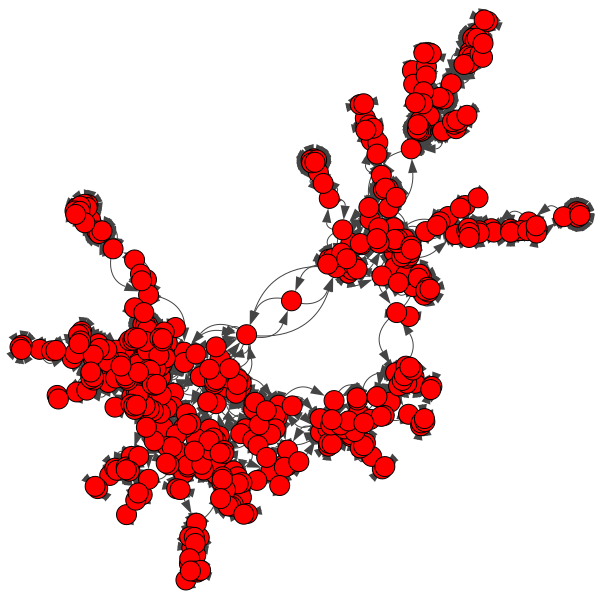

In [ ]:
# https://igraph.org/python/doc/tutorial/tutorial.html#layouts-and-plotting
g1 = ig.Graph.TupleList(tuples_weight, directed = True, edge_attrs = ['name', 'weight'])
# g['layout'] = g.layout_grid_fruchterman_reingold()
ig.plot(g1, vertex_label = ' ')

In [ ]:
g1_nodes_count = g1.vcount()
g1_edges_count = g1.ecount()
print('Graph: {0} nodes, {1} edges'.format(g1_nodes_count, g1_edges_count))

Graph: 516 nodes, 2376 edges


In [ ]:
# DEBUG
if(g1_nodes_count == len(nodes_nogenes)):
  print('Nodes imported correctly!')
if(g1_edges_count == len(edges_diseases)):
  print('Edges imported correctly!')

Nodes imported correctly!
Edges imported correctly!


In [ ]:
print('Attributes of vertex: {0}'.format(g1.vs.attribute_names()))
print()
print('Name of first 10 vertex: {0}'.format(g1.vs.get_attribute_values('name')[:10]))

Attributes of vertex: ['name']

Name of first 10 vertex: [1285, 858, 468, 81, 416, 411, 417, 126, 125, 127]


In [ ]:
print('Attributes of edges: {0}'.format(g1.es.attribute_names()))

Attributes of edges: ['name', 'weight']


In [ ]:
for name in g1.vs.get_attribute_values('name'):
  # print(name)
  g1.vs.select(name = name)["label"] = nodes_nogenes.loc[nodes_nogenes['id'] == name, 'label'].item()
  g1.vs.select(name = name)["type"] = nodes_nogenes.loc[nodes_nogenes['id'] == name, '0'].item()
  g1.vs.select(name = name)["category"] = nodes_nogenes.loc[nodes_nogenes['id'] == name, '1'].item()

print('Attributes of vertex: {0}'.format(g1.vs.attribute_names()))

Attributes of vertex: ['name', 'label', 'type', 'category']


In [ ]:
print('Label of vertex 45: {0}'.format(g1.vs.select(name = 45)["label"]))
print('Type of vertex 45: {0}'.format(g1.vs.select(name = 45)["type"]))
print('Category of vertex 45: {0}'.format(g1.vs.select(name = 45)["category"]))
print()
print('Label of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["label"]))
print('Type of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["type"]))
print('Category of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["category"]))

Label of vertex 45: ['Retinitis pigmentosa']
Type of vertex 45: ['disease']
Category of vertex 45: ['Ophthamological']

Label of vertex 3985: []
Type of vertex 3985: []
Category of vertex 3985: []


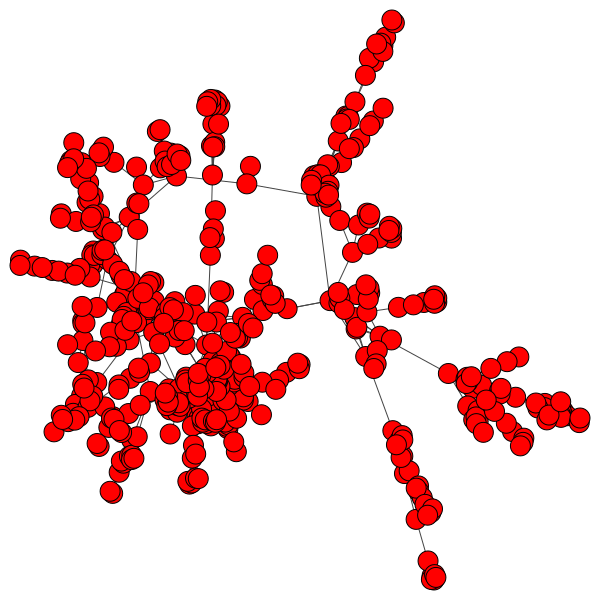

In [ ]:
g1.to_undirected(mode = 'collapse', combine_edges = "first")
ig.plot(g1, vertex_label = ' ')

In [ ]:
g1_nodes_count = g1.vcount()
g1_edges_count = g1.ecount()
print('Graph: {0} nodes, {1} edges'.format(g1_nodes_count, g1_edges_count))

Graph: 516 nodes, 1188 edges


In [ ]:
print('Attributes of edges: {0}'.format(g1.es.attribute_names()))
print()
print('Name of first 10 edges: {0}'.format(g1.es.get_attribute_values('name')[:10]))
print('Weight of first 10 edges: {0}'.format(g1.es.get_attribute_values('weight')[:10]))

Attributes of edges: ['name', 'weight']

Name of first 10 edges: [1550, 1551, 1552, 1553, 2510, 1554, 1555, 2541, 1556, 1557]
Weight of first 10 edges: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


## Clustering Coefficient

In [ ]:
# g1.transitivity_local_undirected(vertices = None, weights = 'weight')
print('Clustering Coefficient (before transformation): {0}'.format(g.transitivity_undirected()))
print('Clustering Coefficient (after transformation): {0}'.format(g1.transitivity_undirected()))

Clustering Coefficient (before transformation): 0.2509545296771954
Clustering Coefficient (after transformation): 0.4304705634100021


# Network Centrality (after transformation)

## Degree (New and Weighted) 

In [ ]:
degree_nodes = []
g1.vs['degree'] = g1.degree(g1.vs)
print('Top 5 MAX Degree in G: {0}'.format(sorted(g1.vs.get_attribute_values('degree'), reverse=True)[:5]))
for degree in sorted(g1.vs.get_attribute_values('degree'), reverse=True)[:5]:
    degree_nodes.append(g1.vs.select(degree = degree)["label"])

print('Top 5 vertex_name with MAX Degree in G:')
print(degree_nodes)

Top 5 MAX Degree in G: [50, 30, 27, 26, 26]
Top 5 vertex_name with MAX Degree in G:
[['Colon cancer'], ['Breast cancer'], ['Gastric cancer'], ['Thyroid carcinoma', 'Leukemia'], ['Thyroid carcinoma', 'Leukemia']]


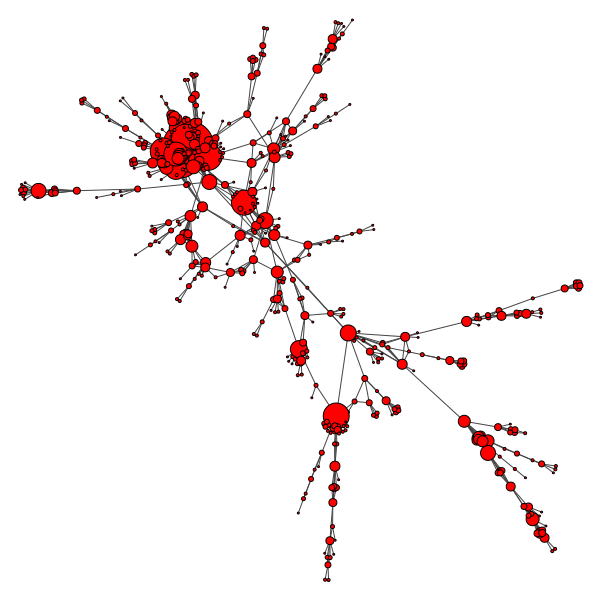

In [ ]:
ig.plot(g1, main="Degree in G", vertex_label = ' ', vertex_size=1*np.array(g1.vs['degree']) + 1)

## Betweenness (New and Weighted) 

In [ ]:
betweenness_nodes = []
g1.vs['betweenness'] = g1.betweenness(g1.vs)
print('Top 5 MAX Betweenness in G: {0}'.format(sorted(g1.vs.get_attribute_values('betweenness'), reverse=True)[:5]))
for betweenness in sorted(g1.vs.get_attribute_values('betweenness'), reverse=True)[:5]:
    betweenness_nodes.append(g1.vs.select(betweenness = betweenness)["label"])
print('Top 5 vertex_name with MAX Betweenness in G:')
print(betweenness_nodes)

Top 5 MAX Betweenness in G: [62124.032679747244, 54197.921430616196, 36821.470889928816, 31406.330502538432, 26509.999346413817]
Top 5 vertex_name with MAX Betweenness in G:
[['Cardiomyopathy'], ['Lipodystrophy'], ['Diabetes mellitus'], ['Glioblastoma'], ['Deafness']]


In [ ]:
betweenness_nodes_w = []
g1.vs['betweenness_w'] = g1.betweenness(g1.vs, weights = 'weight')
print('Top 5 MAX Betweenness Weighted in G: {0}'.format(sorted(g1.vs.get_attribute_values('betweenness_w'), reverse=True)[:5]))
for betweenness in sorted(g1.vs.get_attribute_values('betweenness_w'), reverse=True)[:5]:
    betweenness_nodes_w.append(g1.vs.select(betweenness_w = betweenness)["label"])
print('Top 5 vertex_name with MAX Betweenness Weighted in G:')
print(betweenness_nodes_w)

Top 5 MAX Betweenness Weighted in G: [62287.266666666634, 57558.73098127361, 42446.43425840592, 32349.630788001068, 23371.833333333198]
Top 5 vertex_name with MAX Betweenness Weighted in G:
[['Cardiomyopathy'], ['Lipodystrophy'], ['Diabetes mellitus'], ['Glioblastoma'], ['Myopathy']]


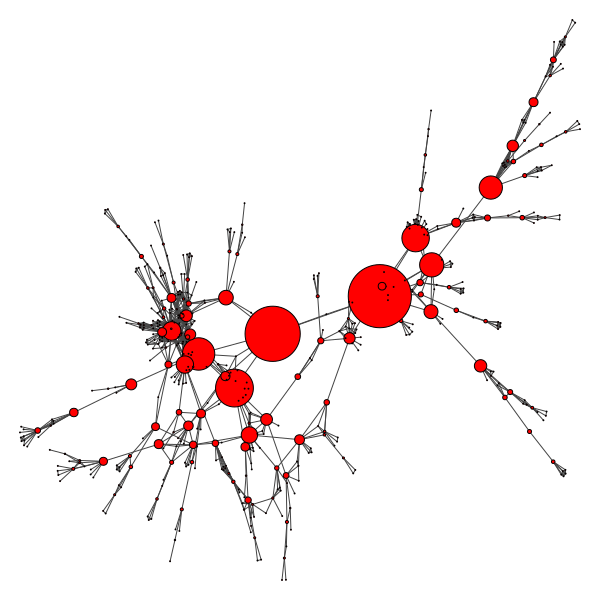

In [ ]:
ig.plot(g1, main="Betweenness in G", vertex_label = ' ', vertex_size=0.001*np.array(g1.vs['betweenness']) + 1)

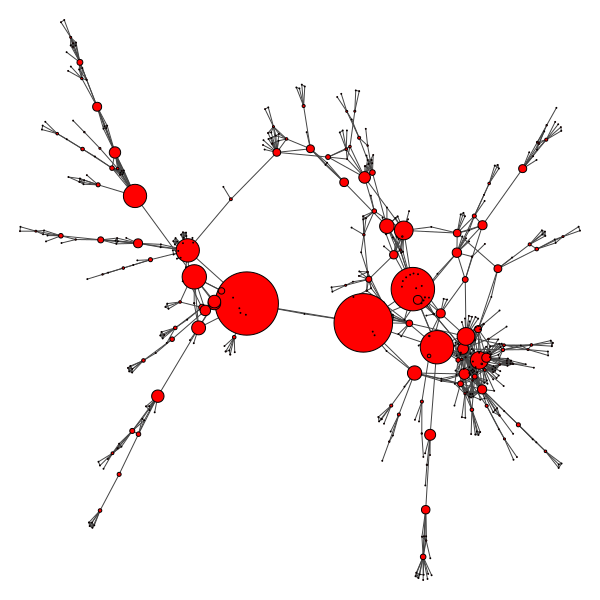

In [ ]:
ig.plot(g1, main="Betweenness Weighted in G", vertex_label = ' ', vertex_size=0.001*np.array(g1.vs['betweenness_w']) + 1)

## Closeness (New and Weighted) 

In [ ]:
closeness_nodes = []
g1.vs['closeness'] = g1.closeness(g.vs)
print('Top 5 MAX Closeness in G: {0}'.format(sorted(g1.vs.get_attribute_values('closeness'), reverse=True)[:5]))
for closeness in sorted(g1.vs.get_attribute_values('closeness'), reverse=True)[:5]:
    closeness_nodes.append(g1.vs.select(closeness = closeness)["label"])
print('Top 5 vertex_name with MAX Closeness in G:')
print(closeness_nodes)

Top 5 MAX Closeness in G: [0.25183374083129584, 0.25060827250608275, 0.2478344562078922, 0.23430391264786168, 0.23187753264295363]
Top 5 vertex_name with MAX Closeness in G:
[['Lipodystrophy'], ['Diabetes mellitus'], ['Glioblastoma'], ['Cardiomyopathy'], ['Obesity']]


In [ ]:
closeness_nodes_w = []
g1.vs['closeness_w'] = g1.closeness(g.vs, weights = 'weight')
print('Top 5 MAX Closeness Weighted in G: {0}'.format(sorted(g1.vs.get_attribute_values('closeness_w'), reverse=True)[:5]))
for closeness in sorted(g1.vs.get_attribute_values('closeness_w'), reverse=True)[:5]:
    closeness_nodes_w.append(g1.vs.select(closeness_w = closeness)["label"])
print('Top 5 vertex_name with MAX Closeness Weighted in G:')
print(closeness_nodes_w)

Top 5 MAX Closeness Weighted in G: [0.23743660673121253, 0.2369995398067188, 0.23526724531749657, 0.2176669484361792, 0.21729957805907174]
Top 5 vertex_name with MAX Closeness Weighted in G:
[['Diabetes mellitus'], ['Lipodystrophy'], ['Glioblastoma'], ['Cardiomyopathy'], ['Insulin resistance']]


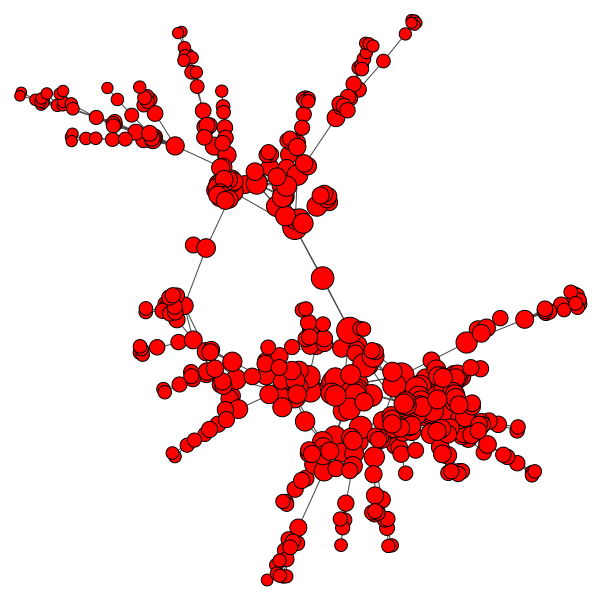

In [ ]:
ig.plot(g1, main="Closeness in G", vertex_label = ' ', vertex_size=100*np.array(g1.vs['closeness']) + 1)

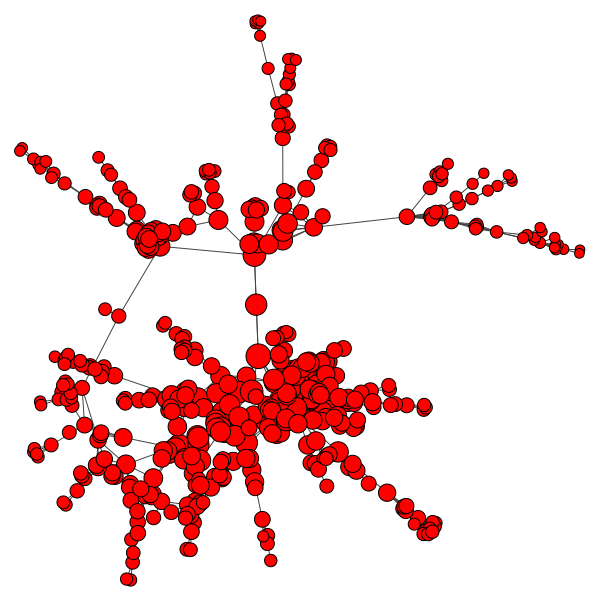

In [ ]:
ig.plot(g1, main="Closeness Weighted in G", vertex_label = ' ', vertex_size=100*np.array(g1.vs['closeness_w']) + 1)

## Eigenvector (New and Weighted) 

In [ ]:
eigenvector_nodes = []
g1.vs['eigenvector_centralities'] = g1.eigenvector_centrality()
print('Top 5 MAX Eigenvector Centralities in G: {0}'.format(sorted(g1.vs.get_attribute_values('eigenvector_centralities'), reverse=True)[:5]))
for eigenvector_centralities in sorted(g1.vs.get_attribute_values('eigenvector_centralities'), reverse=True)[:5]:
    eigenvector_nodes.append(g1.vs.select(eigenvector_centralities = eigenvector_centralities)["label"])
print('Top 5 vertex_name with MAX Eigenvector Centralities in G:')
print(eigenvector_nodes)

Top 5 MAX Eigenvector Centralities in G: [1.0, 0.7706634205589715, 0.6472351048664632, 0.6139192264158735, 0.5101682483951592]
Top 5 vertex_name with MAX Eigenvector Centralities in G:
[['Colon cancer'], ['Breast cancer'], ['Thyroid carcinoma'], ['Pancreatic cancer'], ['Hepatic adenoma']]


In [ ]:
eigenvector_nodes_w = []
g1.vs['eigenvector_centralities_w'] = g1.eigenvector_centrality(weights = 'weight')
print('Top 5 MAX Eigenvector Centralities Weighted in G: {0}'.format(sorted(g1.vs.get_attribute_values('eigenvector_centralities_w'), reverse=True)[:5]))
for eigenvector_centralities in sorted(g1.vs.get_attribute_values('eigenvector_centralities_w'), reverse=True)[:5]:
    eigenvector_nodes_w.append(g1.vs.select(eigenvector_centralities_w = eigenvector_centralities)["label"])
print('Top 5 vertex_name with MAX Eigenvector Centralities Weighted in G:')
print(eigenvector_nodes_w)

Top 5 MAX Eigenvector Centralities Weighted in G: [1.0, 0.7993210870966325, 0.6073937954721106, 0.4704248528729701, 0.4353876312520444]
Top 5 vertex_name with MAX Eigenvector Centralities Weighted in G:
[['Colon cancer'], ['Breast cancer'], ['Ovarian cancer'], ['Lymphoma'], ['Pancreatic cancer']]


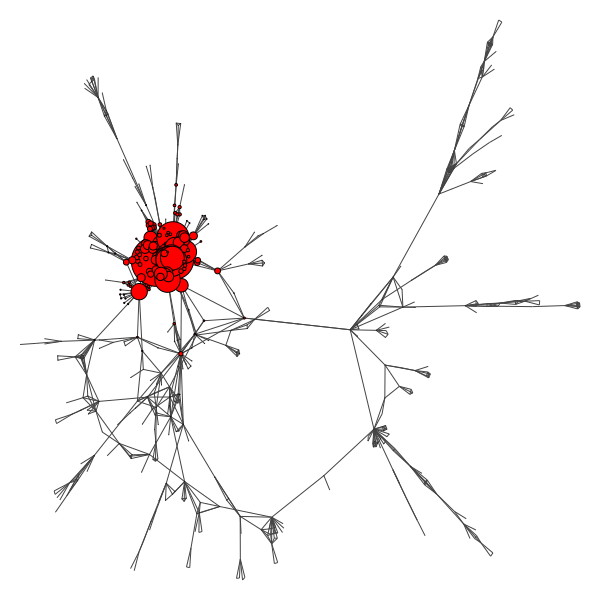

In [ ]:
ig.plot(g1, main="Eigenvector Centralities in G", vertex_label = ' ', vertex_size=50*np.array(g1.vs['eigenvector_centralities']))

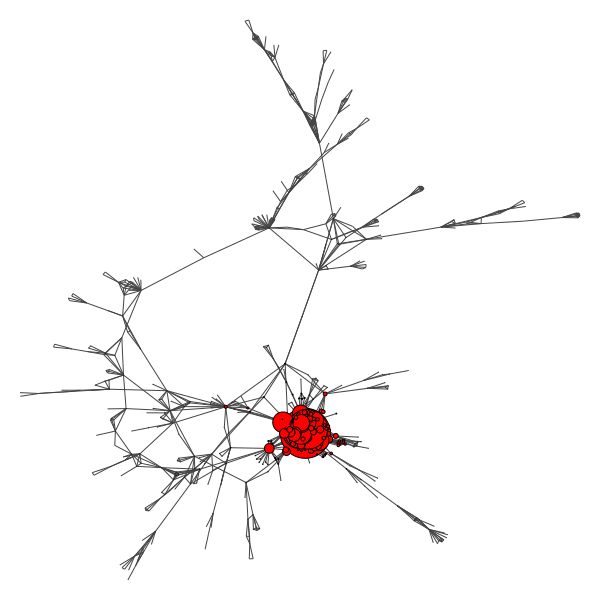

In [ ]:
ig.plot(g1, main="Eigenvector Centralities Weighted in G", vertex_label = ' ', vertex_size=50*np.array(g1.vs['eigenvector_centralities_w']))

## PageRank (New and Weighted) 

In [ ]:
pagerank_nodes = []
g1.vs['pagerank'] = g1.pagerank(g.vs)
print('Top 5 MAX PageRank in G: {0}'.format(sorted(g1.vs.get_attribute_values('pagerank'), reverse=True)[:5]))
for pagerank in sorted(g1.vs.get_attribute_values('pagerank'), reverse=True)[:5]:
    pagerank_nodes.append(g1.vs.select(pagerank = pagerank)["label"])
print('Top 5 vertex_name with MAX PageRank in G:')
print(pagerank_nodes)

Top 5 MAX PageRank in G: [0.013172114394997967, 0.011100957805474388, 0.010383534135683563, 0.009038997833850666, 0.007909833843862615]
Top 5 vertex_name with MAX PageRank in G:
[['Colon cancer'], ['Deafness'], ['Diabetes mellitus'], ['Leukemia'], ['Breast cancer']]


In [ ]:
pagerank_nodes_w = []
g1.vs['pagerank_w'] = g1.pagerank(g.vs, weights = 'weight')
print('Top 5 MAX PageRank Weighted in G: {0}'.format(sorted(g1.vs.get_attribute_values('pagerank_w'), reverse=True)[:5]))
for pagerank in sorted(g1.vs.get_attribute_values('pagerank_w'), reverse=True)[:5]:
    pagerank_nodes_w.append(g1.vs.select(pagerank_w = pagerank)["label"])
print('Top 5 vertex_name with MAX PageRank Weighted in G:')
print(pagerank_nodes_w)

Top 5 MAX PageRank Weighted in G: [0.013172114394997967, 0.011100957805474388, 0.010383534135683563, 0.009038997833850666, 0.007909833843862615]
Top 5 vertex_name with MAX PageRank Weighted in G:
[['Colon cancer'], ['Deafness'], ['Diabetes mellitus'], ['Leukemia'], ['Breast cancer']]


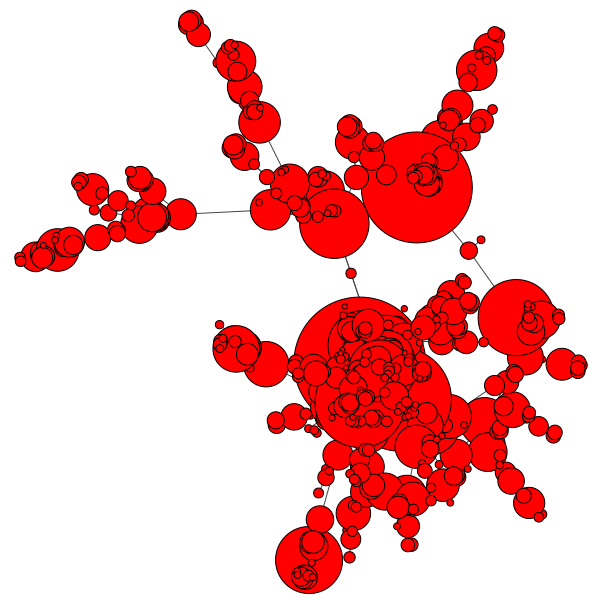

In [ ]:
ig.plot(g1, main="PageRank in G", vertex_label = ' ', vertex_size=10000*np.array(g1.vs['pagerank']))

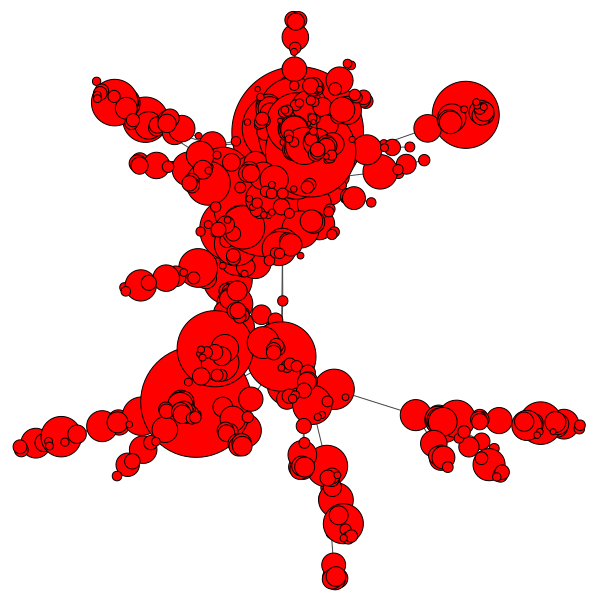

In [ ]:
ig.plot(g1, main="PageRank Weighted in G", vertex_label = ' ', vertex_size=10000*np.array(g1.vs['pagerank']))

In [ ]:
print('Attributes of vertex: {0}'.format(g1.vs.attribute_names()))

Attributes of vertex: ['name', 'label', 'type', 'category', 'degree', 'betweenness', 'betweenness_w', 'closeness', 'closeness_w', 'eigenvector_centralities', 'eigenvector_centralities_w', 'pagerank', 'pagerank_w']


In [ ]:
print('Label of vertex 45: {0}'.format(g1.vs.select(name = 45)["label"]))
print('Type of vertex 45: {0}'.format(g1.vs.select(name = 45)["type"]))
print('Category of vertex 45: {0}'.format(g1.vs.select(name = 45)["category"]))
print()
print('Label of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["label"]))
print('Type of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["type"]))
print('Category of vertex 3985: {0}'.format(g1.vs.select(name = 3985)["category"]))

Label of vertex 45: ['Retinitis pigmentosa']
Type of vertex 45: ['disease']
Category of vertex 45: ['Ophthamological']

Label of vertex 3985: []
Type of vertex 3985: []
Category of vertex 3985: []


# Community Detection

### Evaluation Metrics

In [ ]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix

def eval_metrics(y_true, y_pred):
  cm = confusion_matrix(y_true, y_pred )
  print(cm)
  metrics = precision_recall_fscore_support(y_true, y_pred, average = 'weighted')
  #print("Precision: " + str(metrics[0]))
  #print("Recall: " + str(metrics[1]))

## Label Propagation

In [ ]:
for i in range(1,100):
  partition_lp = g1.community_label_propagation()
  ig.plot(partition_lp, vertex_label = ' ')

  partition_lp = g1.community_label_propagation()
  ig.plot(partition_lp, vertex_label = ' ')

  g1.vs['community_label_propagation'] = partition_lp.membership
  g1.vs['predicted_partition_community_label_propagation'] = ''
  list_community_MVP = set(partition_lp.membership) # prendo tutti gli ID del cluster

  # ciclo su tutti le community
  for community in list_community_MVP:
    most_frequent = {'Metabolic':0, 'Ophthamological':0, 'Multiple': 0, 'Neurological':0, 'Gastrointestinal':0, 'Bone':0, 'Skeletal':0, 'Connective tissue disorder':0, 'Cancer':0, 'Cardiovascular':0, 'Endocrine':0, 
      'Immunological':0, 'Hematological':0, 'Ear,Nose,Throat':0, 'Dermatological':0, 'Unclassified':0, 'Nutritional':0, 'Psychiatric':0, 'Respiratory':0, 'Renal':0, 'Muscular':0,'Developmental':0}

    for v in g1.vs:
      if v['community_label_propagation'] == community:
        real_community = v['category']
        most_frequent[real_community] += 1   

    # per ogni community, prendo la label della malattia con la massima frequenza
    most_frequent_community_into_the_partition = max(most_frequent, key = most_frequent.get)

    # assegno la label più frequente alla predicted partition
    for v in g1.vs:
      if v['community_label_propagation'] == community:
        v['predicted_partition_community_label_propagation'] = most_frequent_community_into_the_partition

  # computo le metriche di Precision, Recall e F1
  y_true = np.array(g1.vs['category'])
  y_pred = np.array(g1.vs['predicted_partition_community_label_propagation'])

  eval_metrics(y_true, y_pred)


  predicted_community = g1.vs['predicted_partition_community_label_propagation']
  actual_community = g1.vs['category']
  list_community = set(actual_community)

  category_dict = {'Metabolic':1, 'Ophthamological':2, 'Multiple': 3, 'Neurological':4, 'Gastrointestinal':5, 'Bone':6, 'Skeletal':7, 'Connective tissue disorder':8, 'Cancer':9, 'Cardiovascular':10, 'Endocrine':11, 
      'Immunological':12, 'Hematological':13, 'Ear,Nose,Throat':14, 'Dermatological':15, 'Unclassified':16, 'Nutritional':17, 'Psychiatric':18, 'Respiratory':19, 'Renal':20, 'Muscular':21,'Developmental':22}

  actual_community = [category_dict[k] for k in actual_community]
  predicted_community = [category_dict[k] for k in predicted_community]

  result_partition_NMI = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "nmi")

  result_partition_rand = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "rand")

  #print(partition_lp.modularity)




[[ 5  0  1  1  0  0  0  1  0  0  0  0  4  0  0  0  0  0  0  0  3  0]
 [ 0 81  0  0  0  0  0  1  0  0  0  0  5  0  0  0  0  0  0  0  1  0]
 [ 0  1 13  1  1  0  0  1  0  0  1  1  3  3  0  0  0  0  0  0  2  0]
 [ 0  1  0  7  0  0  0  0  0  0  1  1  3  0  0  0  0  0  0  0  2  0]
 [ 0  3  0  0 13  0  0  0  0  0  1  0  4  0  0  0  0  0  0  0  0  0]
 [ 0  1  0  0  0  0  0  0  0  0  0  1  0  0  1  0  2  0  0  0  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0]
 [ 0  8  2  0  0  0  0 11  0  0  0  3  0  1  2  0  0  0  0  0  0  0]
 [ 0  0  1  0  0  0  0  0  0  0  0  1  2  0  0  0  0  0  0  0  0  0]
 [ 0  7  1  0  0  0  0  0  0 17  1  0  3  0  3  0  2  0  0  0  0  0]
 [ 0  4  2  0  0  0  0  0  0  2 13  0  0  0  3  0  0  0  0  0  0  0]
 [ 1  1  1  0  1  0  0  0  0  5  0 17  0  2  2  0  1  1  0  0  0  0]
 [ 0 11  1  1  2  0  0  1  0  0  0  5 22  2  3  0  3  0  0  0  3  0]
 [ 0  2  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0  0  0]
 [ 1  1  2  0  0  0  0  0  0  0  1

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[[ 6  0  1  0  0  0  0  1  0  0  0  0  4  0  0  0  0  0  0  0  3  0]
 [ 0 77  0  0  0  0  0  1  0  0  0  0  5  0  2  0  0  0  0  0  3  0]
 [ 0  0 13  1  1  0  0  1  0  0  1  1  4  3  0  0  0  0  0  0  2  0]
 [ 4  1  0  3  0  0  0  0  0  0  1  1  3  0  0  0  0  0  0  0  2  0]
 [ 0  3  0  0 13  0  0  0  0  0  1  0  2  0  0  0  0  0  0  0  2  0]
 [ 0  1  0  0  0  0  0  0  0  0  0  1  0  0  1  0  2  0  0  0  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0]
 [ 0  7  2  0  0  0  0 10  0  0  0  5  0  1  2  0  0  0  0  0  0  0]
 [ 0  0  1  0  0  0  0  0  0  0  0  1  0  0  2  0  0  0  0  0  0  0]
 [ 0  7  1  0  0  0  0  0  0 20  1  0  0  0  3  0  2  0  0  0  0  0]
 [ 0  4  2  0  0  0  0  0  0  2 12  1  0  0  2  0  0  0  0  0  1  0]
 [ 1  1  1  0  1  0  0  0  0  5  1 17  0  2  1  0  1  1  0  0  0  0]
 [ 0 10  1  1  2  0  0  1  0  1  0  5 22  2  4  0  1  0  0  0  4  0]
 [ 0  1  0  0  0  0  0  0  0  0  0  2  0 12  0  0  0  0  0  0  0  0]
 [ 1  1  1  0  0  0  0  0  0  0  1

## Vertex Partition (Louvain)

Partition Modularity: 0.8315524067838881
Partition Membership: [7, 7, 10, 10, 4, 4, 4, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 6, 6, 15, 15, 8, 8, 8, 8, 8, 8, 1, 0, 1, 1, 1, 1, 16, 16, 1, 1, 1, 1, 1, 17, 17, 0, 0, 0, 0, 0, 14, 14, 5, 5, 5, 5, 15, 2, 15, 0, 0, 4, 4, 4, 4, 4, 11, 11, 11, 9, 9, 9, 9, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 9, 9, 5, 5, 5, 5, 5, 5, 5, 23, 23, 0, 23, 23, 0, 0, 0, 0, 14, 14, 14, 14, 10, 10, 10, 10, 4, 4, 4, 4, 4, 4, 4, 4, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 22, 22, 22, 22, 22, 22, 4, 7, 7, 7, 7, 7, 1, 1, 1, 1, 1, 1, 1, 3, 14, 8, 8, 8, 8, 8, 8, 2, 2, 10, 9, 3, 9, 9, 9, 9, 9, 9, 10, 10, 1, 1, 1, 2, 2, 9, 15, 15, 15, 11, 15, 15, 15, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 17, 17, 17, 17, 11, 11, 2, 2, 2, 2, 2, 7, 7, 7, 7, 7, 7, 11, 11, 11, 12, 12, 18, 18, 18, 1, 0, 0, 0, 1, 14, 14, 14, 13, 13, 13, 13, 13, 13, 13, 6, 6, 6, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 15, 15, 15, 15, 6, 6, 6, 17, 17, 1, 1, 1, 1, 13, 13, 13, 13, 1, 18, 18, 18, 18, 11, 11, 11, 3, 3, 11

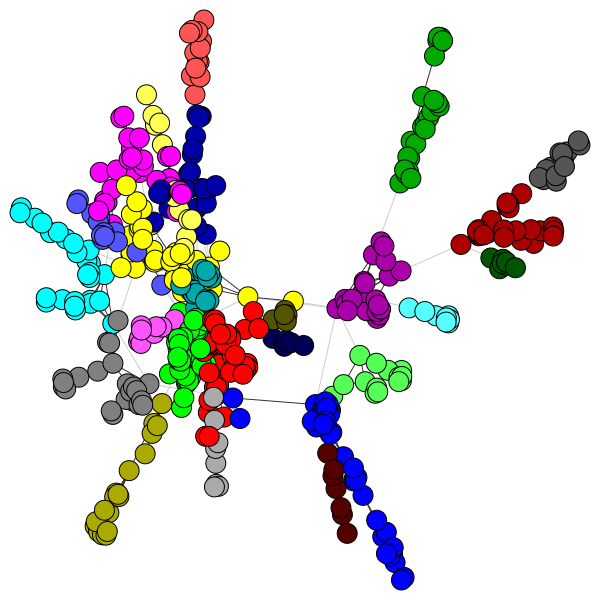

In [ ]:
partition = louvain.find_partition(g1, louvain.ModularityVertexPartition, weights=g1.es['weight'])
print('Partition Modularity: {0}'.format(partition.modularity))
print('Partition Membership: {0}'.format(partition.membership))
ig.plot(partition, vertex_label = ' ')

In [ ]:
g1.vs['ModularityVertexPartition'] = partition.membership
g1.vs['predicted_partition_ModularityVertexPartition'] = ''
list_community_MVP = set(partition.membership) # prendo tutti gli ID del cluster

# ciclo su tutti le community
for community in list_community_MVP:
  most_frequent = {'Metabolic':0, 'Ophthamological':0, 'Multiple': 0, 'Neurological':0, 'Gastrointestinal':0, 'Bone':0, 'Skeletal':0, 'Connective tissue disorder':0, 'Cancer':0, 'Cardiovascular':0, 'Endocrine':0, 
     'Immunological':0, 'Hematological':0, 'Ear,Nose,Throat':0, 'Dermatological':0, 'Unclassified':0, 'Nutritional':0, 'Psychiatric':0, 'Respiratory':0, 'Renal':0, 'Muscular':0,'Developmental':0}

  for v in g1.vs:
    if v['ModularityVertexPartition'] == community:
      real_community = v['category']
      most_frequent[real_community] += 1   

  # per ogni community, prendo la label della malattia con la massima frequenza
  most_frequent_community_into_the_partition = max(most_frequent, key = most_frequent.get)

  # assegno la label più frequente alla predicted partition
  for v in g1.vs:
    if v['ModularityVertexPartition'] == community:
      v['predicted_partition_ModularityVertexPartition'] = most_frequent_community_into_the_partition

# computo le metriche di Precision, Recall e F1
y_true = np.array(g1.vs['category'])
y_pred = np.array(g1.vs['predicted_partition_ModularityVertexPartition'])

eval_metrics(y_true, y_pred)

[[ 6  0  0  0  1  0  0  0  0  0  0  1  7  0  0  0  0  0  0  0  0  0]
 [ 0 85  0  0  1  0  0  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0]
 [ 0  1 10  0  2  0  0  0  0  0  0  6  0  3  2  0  3  0  0  0  0  0]
 [ 4  2  0  0  0  0  0  0  0  0  1  1  3  0  0  0  4  0  0  0  0  0]
 [ 0  3  0  0 13  0  0  0  0  0  0  0  2  0  1  0  0  0  0  0  2  0]
 [ 0  2  0  0  0  0  0  0  0  0  0  1  0  0  1  0  2  0  0  0  2  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0]
 [ 0  8  0  0  3  0  0  8  0  0  0  5  0  1  2  0  0  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0]
 [ 0  7  0  0  0  0  0  0  0 18  0  1  3  0  3  0  2  0  0  0  0  0]
 [ 0  4  0  0  0  0  0  0  0  2 10  2  0  0  6  0  0  0  0  0  0  0]
 [ 1  2  0  0  1  0  0  0  0 11  0  7  0  5  4  0  1  0  0  0  0  0]
 [ 0 22  2  0  3  0  0  0  0  1  0  2 10  4  3  0  6  0  0  0  1  0]
 [ 0  2  0  0  0  0  0  0  0  0  0  1  0 12  0  0  0  0  0  0  0  0]
 [ 1  4  0  0  0  0  0  0  0  2  1

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
predicted_community = g1.vs['predicted_partition_ModularityVertexPartition']
actual_community = g1.vs['category']
list_community = set(predicted_community)
print(len(list_community))
# NMI e Rand Index vogliono valori interi e non stringhe
category_dict = {'Metabolic':1, 'Ophthamological':2, 'Multiple': 3, 'Neurological':4, 'Gastrointestinal':5, 'Bone':6, 'Skeletal':7, 'Connective tissue disorder':8, 'Cancer':9, 'Cardiovascular':10, 'Endocrine':11, 
     'Immunological':12, 'Hematological':13, 'Ear,Nose,Throat':14, 'Dermatological':15, 'Unclassified':16, 'Nutritional':17, 'Psychiatric':18, 'Respiratory':19, 'Renal':20, 'Muscular':21,'Developmental':22}

actual_community = [category_dict[k] for k in actual_community]
predicted_community = [category_dict[k] for k in predicted_community]

# In both cases, the similarity score exists in the range [0, 1], where 1 corresponds to identical clusterings and 0 implies maximally dissimilar clusterings.
# The Normalized Mutual Information (NMI) has been widely used to evaluate the accuracy of community detection algorithms. However in this article we show that the NMI is 
# seriously affected by systematic errors due to finite size of networks, and may give a wrong estimate of performance of algorithms in some cases. We give a simple theory to the finite-size effect of NMI 
# and test our theory numerically. Then we propose a new metric for the accuracy of community detection, namely the relative Normalized Mutual Information (rNMI), which considers statistical significance of
# the NMI by comparing it with the expected NMI of random partitions. Our numerical experiments show that the rNMI overcomes the finite-size effect of the NMI.
result_partition_NMI = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "nmi")
print("Normalized Mutual Information: " + str(result_partition_NMI))

# In both cases, the similarity score exists in the range [0, 1], where 1 corresponds to identical clusterings and 0 implies maximally dissimilar clusterings. 
# The Rand Index is the same of 'Data and Text Mining' course
result_partition_rand = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "rand")
print("Rand Index: " + str(result_partition_rand))

13
Normalized Mutual Information: 0.41628645032812883
Rand Index: 0.8543538797320691


## Infomap

0.7841550323663122


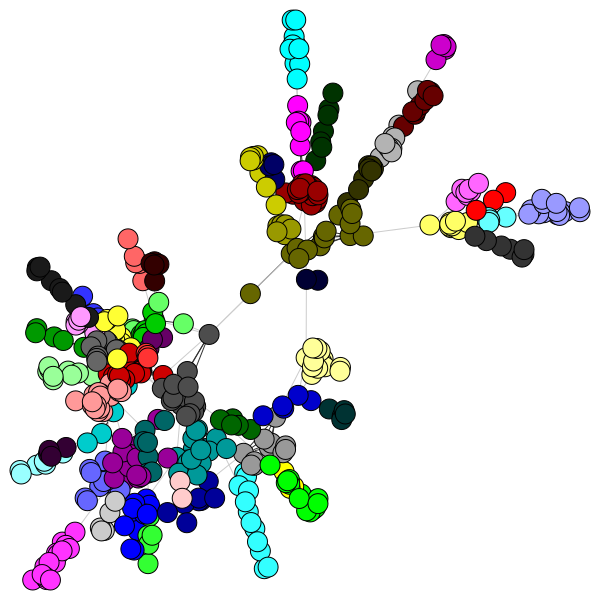

In [ ]:
partition_i = g1.community_infomap( trials = 4)
pal = ig.drawing.colors.ClusterColoringPalette(len(partition_i))
g1.vs['color_infomap'] = pal.get_many(partition_i.membership)
print(partition_i.modularity)
ig.plot(partition_i, vertex_label=' ')

In [ ]:
g1.vs['community_infomap'] = partition_i.membership
g1.vs['predicted_partition_community_infomap'] = ''
list_community_MVP = set(partition_i.membership) # prendo tutti gli ID del cluster
print(len(list_community_MVP))
# ciclo su tutti le community
for community in list_community_MVP:
  most_frequent = {'Metabolic':0, 'Ophthamological':0, 'Multiple': 0, 'Neurological':0, 'Gastrointestinal':0, 'Bone':0, 'Skeletal':0, 'Connective tissue disorder':0, 'Cancer':0, 'Cardiovascular':0, 'Endocrine':0, 
     'Immunological':0, 'Hematological':0, 'Ear,Nose,Throat':0, 'Dermatological':0, 'Unclassified':0, 'Nutritional':0, 'Psychiatric':0, 'Respiratory':0, 'Renal':0, 'Muscular':0,'Developmental':0}

  for v in g1.vs:
    if v['community_infomap'] == community:
      real_community = v['category']
      most_frequent[real_community] += 1   

  # per ogni community, prendo la label della malattia con la massima frequenza
  most_frequent_community_into_the_partition = max(most_frequent, key = most_frequent.get)

  # assegno la label più frequente alla predicted partition
  for v in g1.vs:
    if v['community_infomap'] == community:
      v['predicted_partition_community_infomap'] = most_frequent_community_into_the_partition

# computo le metriche di Precision, Recall e F1
y_true = np.array(g1.vs['category'])
y_pred = np.array(g1.vs['predicted_partition_community_infomap'])

eval_metrics(y_true, y_pred)

57
[[ 6  0  1  0  0  0  0  1  0  0  0  0  4  0  0  0  0  0  0  0  3  0]
 [ 0 74  0  0  0  0  0  1  0  0  0  1  8  0  0  0  0  0  0  0  4  0]
 [ 0  0 13  1  2  0  0  0  0  0  0  1  4  3  1  0  0  0  0  0  2  0]
 [ 4  1  0  3  0  0  0  0  0  0  1  1  3  0  0  0  0  0  0  0  2  0]
 [ 0  2  0  0 13  0  0  0  0  0  0  0  3  0  1  0  0  0  0  0  2  0]
 [ 0  1  0  0  0  0  0  0  0  0  0  1  1  0  1  0  1  0  0  0  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0]
 [ 0  6  1  0  0  0  0 14  0  0  0  4  0  1  1  0  0  0  0  0  0  0]
 [ 0  0  1  0  0  0  0  0  0  0  0  1  2  0  0  0  0  0  0  0  0  0]
 [ 0  7  1  0  0  0  0  0  0 17  0  1  3  0  3  0  2  0  0  0  0  0]
 [ 0  4  2  0  0  0  0  0  0  2 10  1  0  0  5  0  0  0  0  0  0  0]
 [ 1  0  1  0  1  0  0  1  0  5  0 18  0  2  1  0  1  1  0  0  0  0]
 [ 0  6  1  1  2  0  0  1  0  0  0  5 27  2  3  0  1  0  0  0  5  0]
 [ 0  1  0  0  0  0  0  1  0  0  0  0  0 13  0  0  0  0  0  0  0  0]
 [ 1  0  1  0  0  0  0  1  0  0

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
predicted_community = g1.vs['predicted_partition_community_infomap']
actual_community = g1.vs['category']
list_community = set(actual_community)

category_dict = {'Metabolic':1, 'Ophthamological':2, 'Multiple': 3, 'Neurological':4, 'Gastrointestinal':5, 'Bone':6, 'Skeletal':7, 'Connective tissue disorder':8, 'Cancer':9, 'Cardiovascular':10, 'Endocrine':11, 
     'Immunological':12, 'Hematological':13, 'Ear,Nose,Throat':14, 'Dermatological':15, 'Unclassified':16, 'Nutritional':17, 'Psychiatric':18, 'Respiratory':19, 'Renal':20, 'Muscular':21,'Developmental':22}

actual_community = [category_dict[k] for k in actual_community]
predicted_community = [category_dict[k] for k in predicted_community]

result_partition_NMI = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "nmi")
print("Normalized Mutual Information: " + str(result_partition_NMI))

result_partition_rand = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "rand")
print("Rand Index: " + str(result_partition_rand))

Normalized Mutual Information: 0.47669424765170665
Rand Index: 0.8955294648904946


## Leading Eigenvector

0.7683983917738305


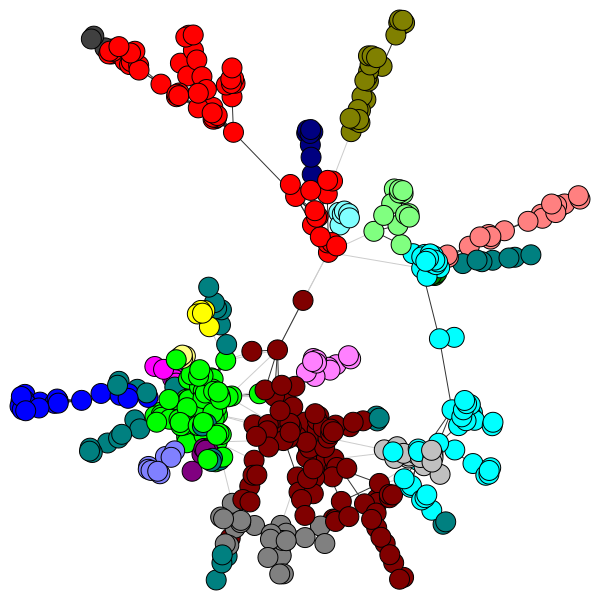

In [ ]:
partition_e = g1.community_leading_eigenvector(clusters = 23, weights = g1.es['weight'])
print(partition_e.modularity)
ig.plot(partition_e, vertex_label = ' ')

In [ ]:
g1.vs['community_leading_eigenvector'] = partition_e.membership
g1.vs['predicted_partition_community_leading_eigenvector'] = ''
list_community_MVP = set(partition_e.membership) # prendo tutti gli ID del cluster

# ciclo su tutti le community
for community in list_community_MVP:
  most_frequent = {'Metabolic':0, 'Ophthamological':0, 'Multiple': 0, 'Neurological':0, 'Gastrointestinal':0, 'Bone':0, 'Skeletal':0, 'Connective tissue disorder':0, 'Cancer':0, 'Cardiovascular':0, 'Endocrine':0, 
     'Immunological':0, 'Hematological':0, 'Ear,Nose,Throat':0, 'Dermatological':0, 'Unclassified':0, 'Nutritional':0, 'Psychiatric':0, 'Respiratory':0, 'Renal':0, 'Muscular':0,'Developmental':0}

  for v in g1.vs:
    if v['community_leading_eigenvector'] == community:
      real_community = v['category']
      most_frequent[real_community] += 1   

  # per ogni community, prendo la label della malattia con la massima frequenza
  most_frequent_community_into_the_partition = max(most_frequent, key = most_frequent.get)

  # assegno la label più frequente alla predicted partition
  for v in g1.vs:
    if v['community_leading_eigenvector'] == community:
      v['predicted_partition_community_leading_eigenvector'] = most_frequent_community_into_the_partition

# computo le metriche di Precision, Recall e F1
y_true = np.array(g1.vs['category'])
y_pred = np.array(g1.vs['predicted_partition_community_leading_eigenvector'])

eval_metrics(y_true, y_pred)

[[ 0  0  0  0  1  0  0  0  0  0  1  0  0  0  0  0  8  0  0  0  5  0]
 [ 0 82  0  0  1  0  0  3  0  0  0  0  0  0  0  0  2  0  0  0  0  0]
 [ 0  1 10  0  2  0  0  1  0  0  7  0  0  0  0  0  6  0  0  0  0  0]
 [ 0  1  0  0  0  0  0  0  0  0  2  0  0  0  0  0  8  0  0  0  4  0]
 [ 0  2  0  0 13  0  0  3  0  0  1  0  1  0  0  0  1  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  3  0  0  1  0  0  0  1  0  2  0  0  0  1  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  3  0  0  0  0  0]
 [ 0  9  0  0  3  0  0  7  0  0  6  0  0  1  1  0  0  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  5  0  0  0  0  0  2  0  9 11  0  0  0  2  0  5  0  0  0  0  0]
 [ 0  5  0  0  0  0  0  4  0  0 15  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  1  0  0  4  0  4 11  3  0  0  1  0  8  0  0  0  0  0]
 [ 0 12  1  0  3  0  0  6  0  0  2  2  8  0  3  0 12  0  0  0  5  0]
 [ 0  2  0  0  0  0  0  0  0  0  1  0  0  4  0  0  8  0  0  0  0  0]
 [ 0  3  0  0  0  0  0  6  0  0 13

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
predicted_community = g1.vs['predicted_partition_community_leading_eigenvector']
actual_community = g1.vs['category']
list_community = set(actual_community)

category_dict = {'Metabolic':1, 'Ophthamological':2, 'Multiple': 3, 'Neurological':4, 'Gastrointestinal':5, 'Bone':6, 'Skeletal':7, 'Connective tissue disorder':8, 'Cancer':9, 'Cardiovascular':10, 'Endocrine':11, 
     'Immunological':12, 'Hematological':13, 'Ear,Nose,Throat':14, 'Dermatological':15, 'Unclassified':16, 'Nutritional':17, 'Psychiatric':18, 'Respiratory':19, 'Renal':20, 'Muscular':21,'Developmental':22}

actual_community = [category_dict[k] for k in actual_community]
predicted_community = [category_dict[k] for k in predicted_community]

result_partition_NMI = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "nmi")
print("Normalized Mutual Information: " + str(result_partition_NMI))

result_partition_rand = ig.compare_communities(comm1 = predicted_community, comm2 = actual_community, method = "rand")
print("Rand Index: " + str(result_partition_rand))

Normalized Mutual Information: 0.36655945791505545
Rand Index: 0.840332655979529


## Pruning

Graph for Clique: 516 nodes, 1188 edges
Iteration...
Iteration...
Iteration...
Iteration...
Graph for Clique: 120 nodes, 461 edges


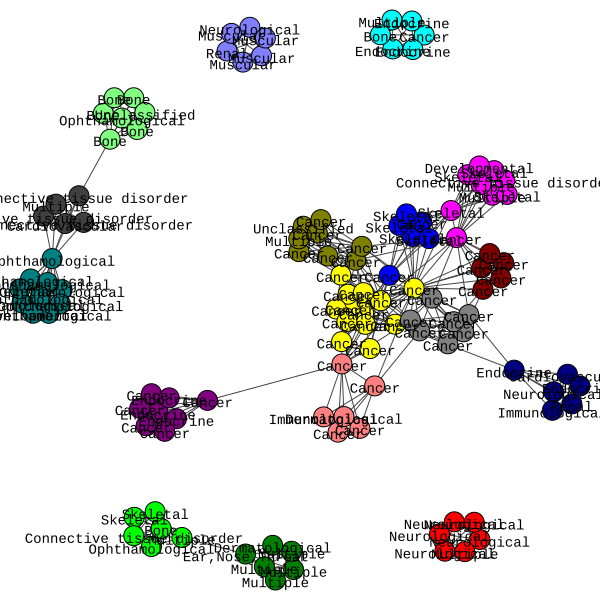

In [ ]:
cliques = g1.copy()
degree_nodes_c = []
cliques.vs['degree'] = cliques.degree(g1.vs)
nodes_count_c = cliques.vcount()
edges_count_c = cliques.ecount()
print('Graph for Clique: {0} nodes, {1} edges'.format(nodes_count_c, edges_count_c))

while not all(i >= 5 for i in cliques.vs['degree']):
  print("Iteration...")
  to_delete_ids = [v.index for v in cliques.vs if v['degree']  < 5]
  cliques.delete_vertices(to_delete_ids)
  cliques.vs['degree'] = cliques.degree(cliques.vs)

nodes_count_c = cliques.vcount()
edges_count_c = cliques.ecount()
print('Graph for Clique: {0} nodes, {1} edges'.format(nodes_count_c, edges_count_c))

# print(cliques.vertex_attributes())

list_community = cliques.vs['category'] 
list_community = list(dict.fromkeys(list_community))

i = cliques.community_infomap()

pal = ig.drawing.colors.ClusterColoringPalette(len(i))
cliques.vs['color'] = pal.get_many(i.membership)
cliques.vs['cliques'] = pal.get_many(i.membership)

ig.plot(cliques, vertex_label = cliques.vs['category'])

In [ ]:
cliques.vs['ModularityVertexPartition'] = i.membership
cliques.vs['predicted_partition_ModularityVertexPartition'] = ''
list_community_MVP = set(i.membership) # prendo tutti gli ID delle community

# ciclo su tutti le community
for community in list_community_MVP:
  most_frequent = {'Metabolic':0, 'Ophthamological':0, 'Multiple': 0, 'Neurological':0, 'Gastrointestinal':0, 'Bone':0, 'Skeletal':0, 'Connective tissue disorder':0, 'Cancer':0, 'Cardiovascular':0, 'Endocrine':0, 
     'Immunological':0, 'Hematological':0, 'Ear,Nose,Throat':0, 'Dermatological':0, 'Unclassified':0, 'Nutritional':0, 'Psychiatric':0, 'Respiratory':0, 'Renal':0, 'Muscular':0,'Developmental':0}

  for v in cliques.vs:
    if v['ModularityVertexPartition'] == community:
      real_community = v['category']
      most_frequent[real_community] += 1   

  # per ogni community, prendo la label della malattia con la massima frequenza
  most_frequent_community_into_the_partition = max(most_frequent, key = most_frequent.get)

  # assegno la label più frequente alla predicted partition
  for v in cliques.vs:
    if v['ModularityVertexPartition'] == community:
      v['predicted_partition_ModularityVertexPartition'] = most_frequent_community_into_the_partition

# computo le metriche di Precision, Recall e F1
y_true = np.array(cliques.vs['category'])
y_pred = np.array(cliques.vs['predicted_partition_ModularityVertexPartition'])

eval_metrics(y_true, y_pred)

[[ 5  0  0  0  0  0  0  1  0  0  0  0  0  0  1  0]
 [ 0 40  0  0  0  0  0  1  0  0  0  0  0  0  3  0]
 [ 0  0  0  1  0  0  0  1  0  0  0  0  0  0  0  0]
 [ 0  0  0  3  0  0  0  0  0  0  0  0  0  0  2  0]
 [ 0  1  0  0  0  0  0  0  0  1  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  0  1  0]
 [ 0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0]
 [ 0  3  0  0  0  0  0  5  0  0  0  0  0  0  0  0]
 [ 0  1  0  0  0  0  0  1  0  0  0  0  0  0  0  0]
 [ 0  1  0  1  0  0  0  1  0  4  0  1  0  0  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  1  0  0  1  5  0  0  0  0]
 [ 1  0  0  0  0  0  0  0  0  0  0  0  8  0  1  0]
 [ 0  0  0  0  0  0  0  1  0  0  1  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  0 10  0]
 [ 1  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0]]


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Unclassified Diseases

In [ ]:
for node in g1.vs:
  if node['category'] == 'Unclassified':
    print(node['label'] + ', ' + node['predicted_partition_community_label_propagation'] + ', ' + node['predicted_partition_community_infomap'])

Alcohol dependence, Psychiatric, Psychiatric
Placental abruption, Cardiovascular, Cardiovascular
Carpal tunnel syndrome, familial, Neurological, Metabolic
Aquaporin-1 deficiency, Hematological, Hematological
Beta-2-adrenoreceptor agonist, reduced response to, Metabolic, Neurological
Bannayan-Riley-Ruvalcaba syndrome, Cancer, Cancer
Benzene toxicity, Multiple, Cancer
van Buchem disease, Bone, Bone
Aneurysm, familial arterial, Connective tissue disorder, Bone
